In [1]:
import pandas as pd
import numpy as np
import os
import random
import datetime
import tensorflow as tf
from tensorflow.keras.optimizers import Adam,SGD
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten,LSTM,TimeDistributed
from keras.layers import Convolution2D, MaxPooling2D,MaxPooling1D,Conv1D
from keras.utils import np_utils
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import optimizers
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from tensorflow import keras
from tensorflow.keras import layers
import matplotlib.pyplot as plt
import IPython
from scipy.io import wavfile
import scipy.signal
import numpy as np
import matplotlib.pyplot as plt
import librosa
%matplotlib inline
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd
import librosa, librosa.display

In [2]:
Fs = 16000
sr = 16000
n_fft = 1024
hop_length = 512
win_length = 1024

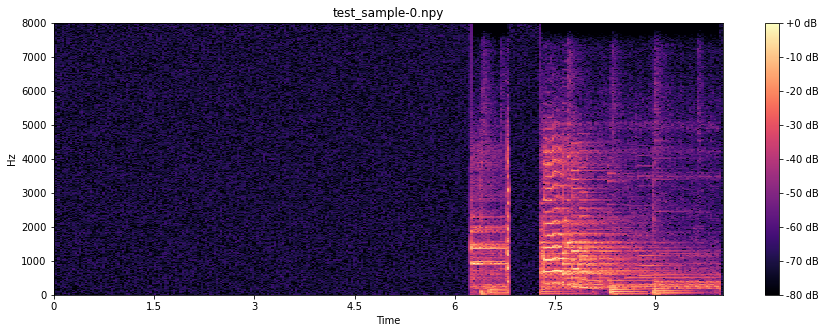

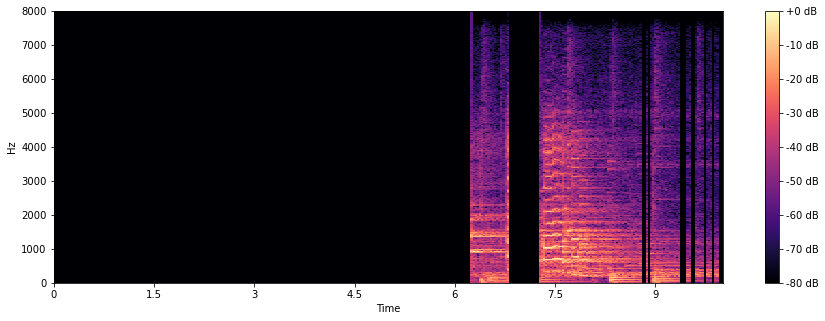

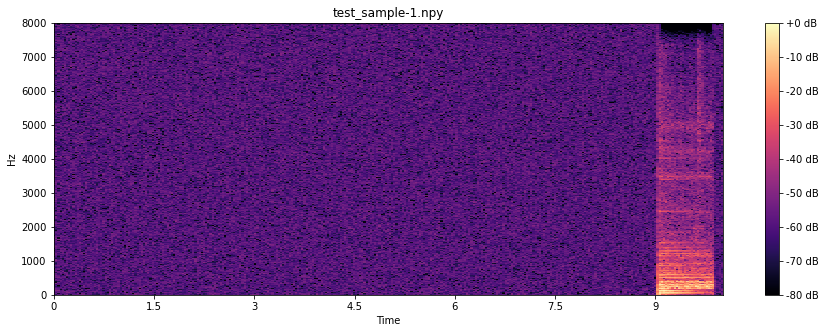

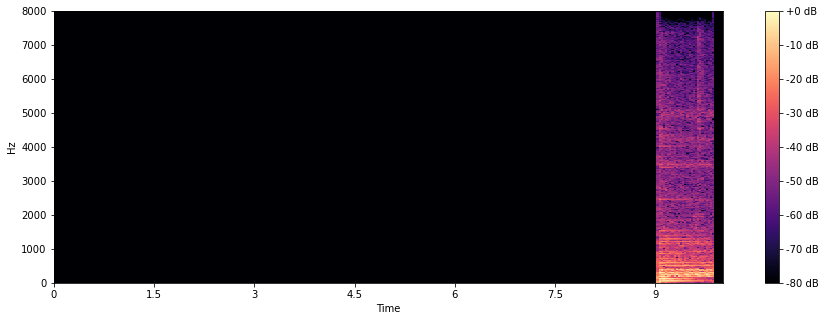

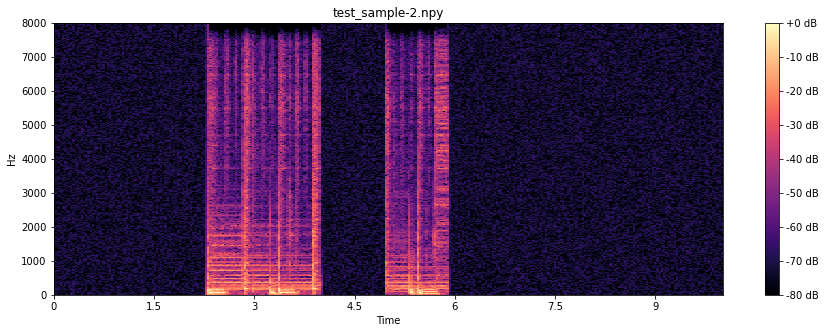

...

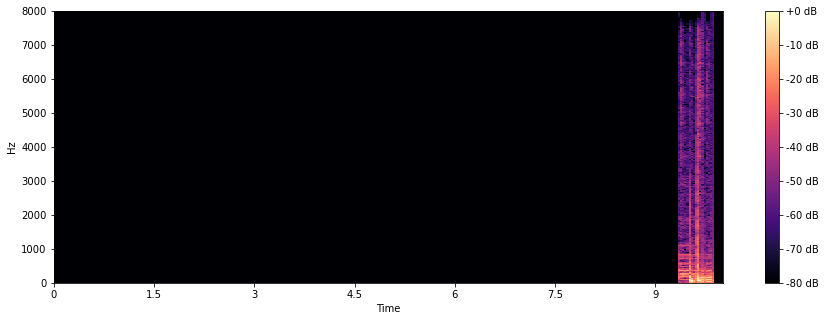

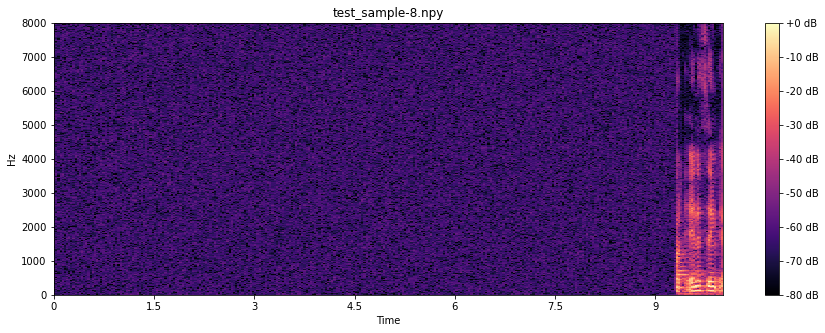

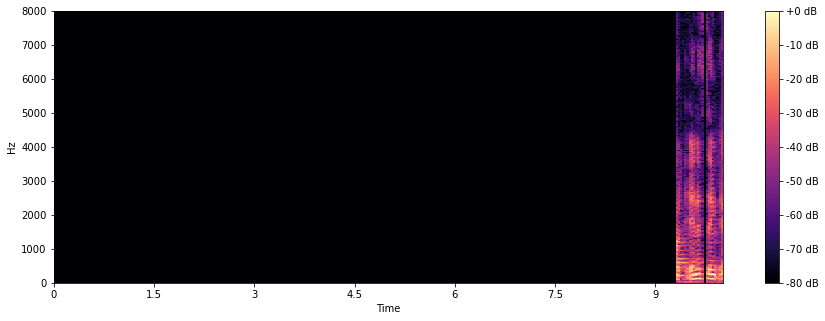

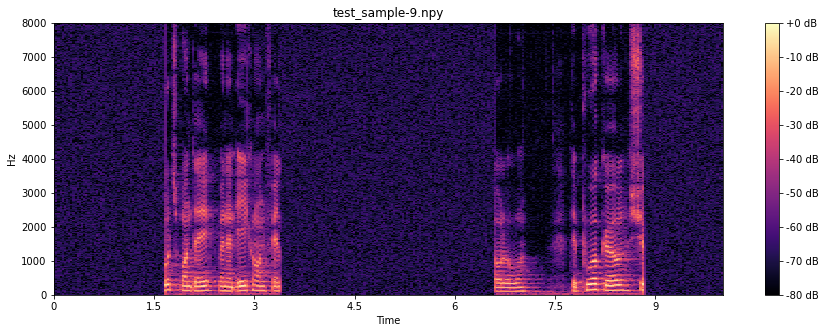

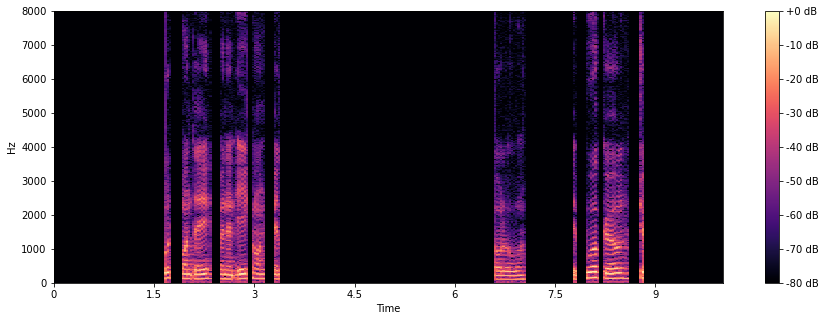

In [3]:
path = "mock_spectrogram/"
x_mfcc = []
for file in os.listdir(path):
    x = np.load(path+file)
    xt = x.T
    k1 = -1e7
    off = []
    plt.figure(figsize=(15, 5))
    librosa.display.specshow(x, sr=Fs, hop_length=hop_length, x_axis='time', y_axis='linear')
    plt.colorbar(format='%+2.0f dB')
    k2 = -1e7
    index = []
    for i in range(len(xt)):
        id = np.argmax(xt[i])
        if(xt[i][id]>-20):
            id2 = np.argmin(xt[i])
            if((xt[i][id2]>k1)and(xt[i][id2]>-80)): k1 = xt[i][id2]
        else:
            if((xt[i][id]>k2)and(xt[i][id]>-80)): k2 = xt[i][id]
            index.append(i)
    if(k1<k2): k = k2
    else: k = k1

    avg = 0
    ni = 0
    for i in index:
        z = xt[i][:]
        avg1 = np.sum(z)/len(z)
        avg = (avg1 + (avg*ni))/(ni+1)
        ni += 1
        z[z<0] = -80
        xt[i][:] = z
    for i in range(len(xt)):
        id = np.argmax(xt[i])
        if(xt[i][id]<=avg):
            z = xt[i][:]
            z[z<0] = -80
            xt[i][:] = z
        
#     xt[xt<avg] = -80      
    plt.title(file)
    plt.figure(figsize=(15, 5))
    librosa.display.specshow(xt.T, sr=Fs, hop_length=hop_length, x_axis='time', y_axis='linear')
    plt.colorbar(format='%+2.0f dB')
    for i in range(0,312,4):
#         print(i)
        x_mfcc.append(librosa.feature.mfcc(S = xt[:][i:i+4].T, sr = Fs, n_mfcc = 64))

<ipython-input-4-80fdf413bfa3>:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15, 5))


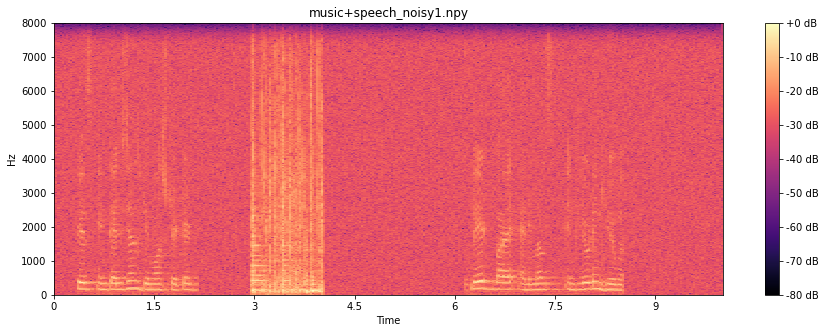

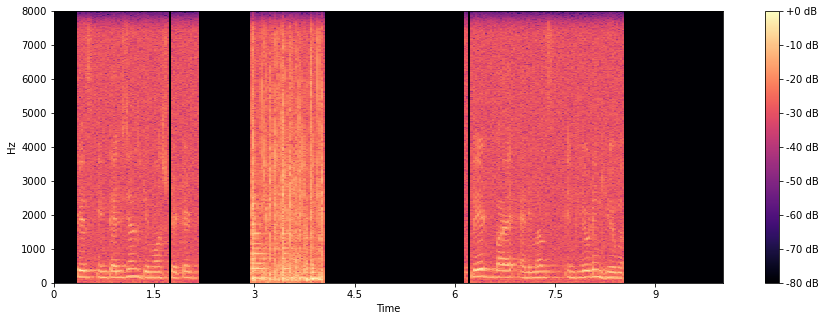

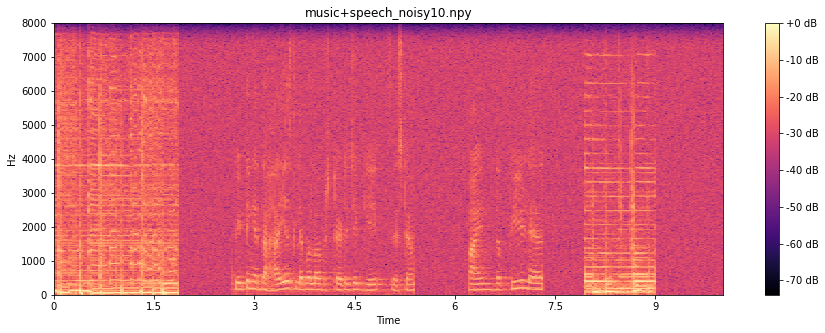

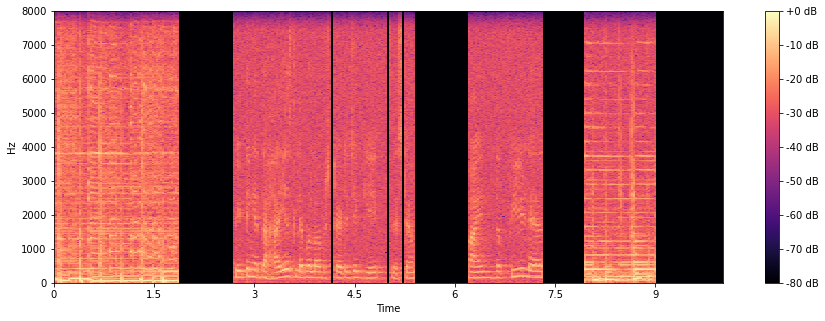

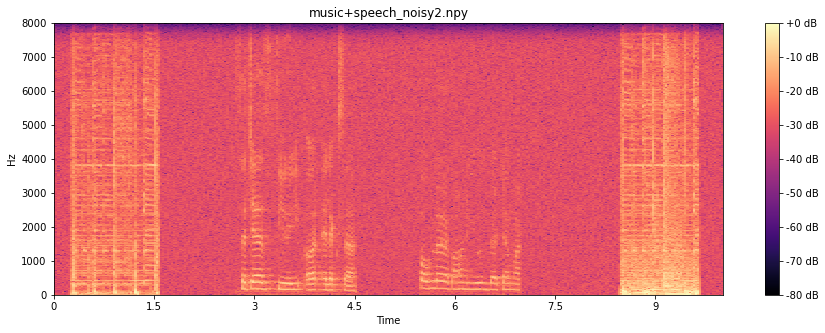

...

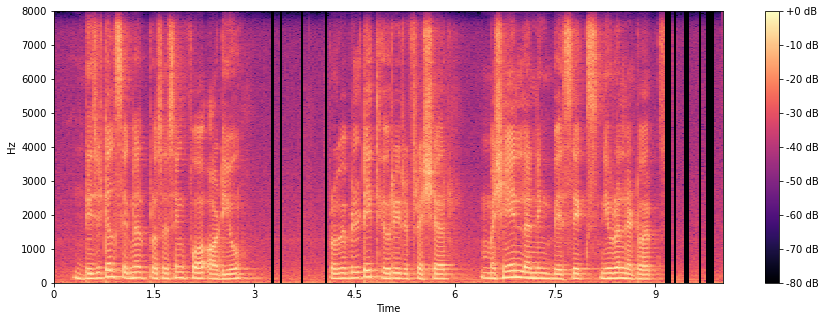

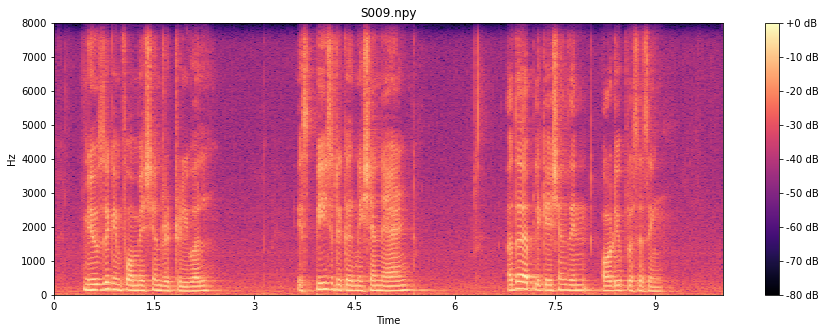

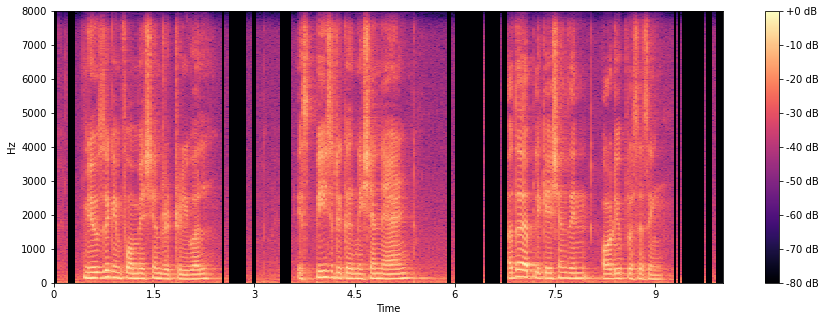

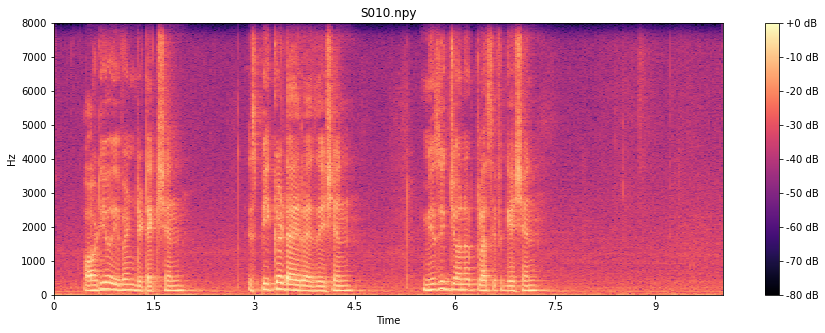

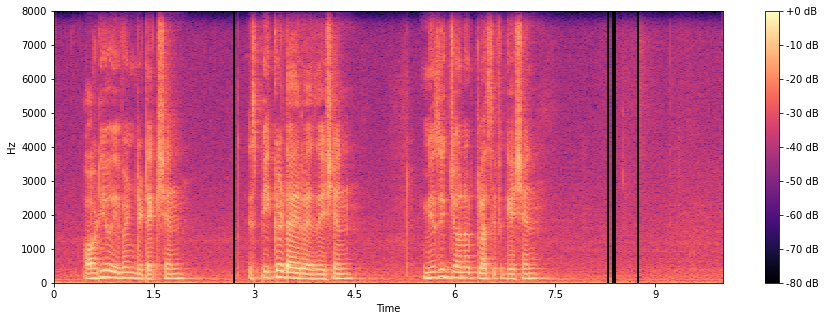

In [4]:
path = "val_set/New_spectrogram/"
x_mfcc = []
on_off = []
for file in os.listdir(path):
    x = np.load(path+file)
    xt = x.T
    k1 = -1e7
    off = []
    plt.figure(figsize=(15, 5))
    librosa.display.specshow(x, sr=Fs, hop_length=hop_length, x_axis='time', y_axis='linear')
    plt.colorbar(format='%+2.0f dB')
    k2 = -1e7
    index = []
    for i in range(len(xt)):
        id = np.argmax(xt[i])
        if(xt[i][id]>-20):
            id2 = np.argmin(xt[i])
            if((xt[i][id2]>k1)and(xt[i][id2]>-80)): k1 = xt[i][id2]
        else:
            if((xt[i][id]>k2)and(xt[i][id]>-80)): k2 = xt[i][id]
            index.append(i)
    
    if(k1<k2): k = k2
    else: k = k1

    avg = 0
    ni = 0
    for i in index:
        z = xt[i][:]
        avg1 = np.sum(z)/len(z)
        avg = (avg1 + (avg*ni))/(ni+1)
        ni += 1
        z[z<0] = -80
        xt[i][:] = z
    for i in range(len(xt)):
        id = np.argmax(xt[i])
        if(xt[i][id]<=avg):
            z = xt[i][:]
            z[z<0] = -80
            xt[i][:] = z
        
#     xt[xt<avg] = -80      
    plt.title(file)
    plt.figure(figsize=(15, 5))
    librosa.display.specshow(xt.T, sr=Fs, hop_length=hop_length, x_axis='time', y_axis='linear')
    plt.colorbar(format='%+2.0f dB')
    for i in range(0,312,4):
#         print(i)
        x_mfcc.append(librosa.feature.mfcc(S = xt[:][i:i+4].T, sr = Fs, n_mfcc = 64))

In [38]:
def noise_reduction(x):
    xt = x.T
    k1 = -1e7
    k2 = -1e7
    index = []
    for i in range(len(xt)):
        id = np.argmax(xt[i])
        if(xt[i][id]>-20):
            id2 = np.argmin(xt[i])
            if((xt[i][id2]>k1)and(xt[i][id2]>-80)): k1 = xt[i][id2]
        else:
            if((xt[i][id]>k2)and(xt[i][id]>-80)): k2 = xt[i][id]
            index.append(i)
    
    if(k1<k2): k = k2
    else: k = k1

    avg = 0
    ni = 0
    
    for i in index:
        z = xt[i][:]
        avg1 = np.sum(z)/len(z)
        avg = (avg1 + (avg*ni))/(ni+1)
        ni += 1
        z[z<0] = -80
        xt[i][:] = z
    
    for i in range(len(xt)):
        id = np.argmax(xt[i])
        if(xt[i][id]<=avg):
            z = xt[i][:]
            z[z<0] = -80
            xt[i][:] = z
    return xt.T

In [41]:
x = np.load("mock_spectrogram/test_sample-0.npy")

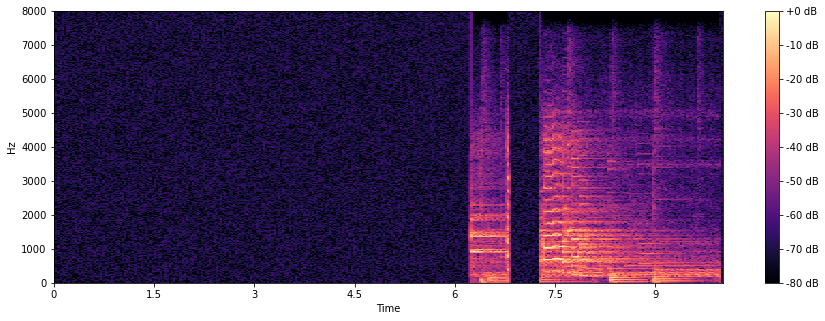

In [42]:
plt.figure(figsize=(15, 5))
librosa.display.specshow(x, sr=Fs, hop_length=hop_length, x_axis='time', y_axis='linear')
plt.colorbar(format='%+2.0f dB')

In [43]:
x = noise_reduction(x)

In [44]:
x.shape

(513, 313)

In [63]:
x_avg = np.sum(x,axis=0)/len(x)
x_avg.shape

(313,)

In [64]:
x_avg = np.array(x_avg)

In [65]:
t = np.full((313), -80)

In [66]:
t.shape

(313,)

In [67]:
k = np.subtract(x_avg,t)

In [87]:
k = k.astype(int)
k.shape

(313,)

In [99]:
k

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0, 33, 25, 25, 24, 27, 30, 30, 29, 27,
       25, 25, 24, 22, 22, 27, 24, 30, 38,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0

In [132]:
on = []
on.append(0)

In [133]:
for i in range(len(k)):
    if(k[i]==38):
        t = i*(10/313)
        print(t)

6.773162939297125


In [134]:
for i in range(len(k)-1):
    l = len(on)
    if(k[i]==0):
        if(k[i+1]!=0):
            if(l!=0):
                if((i-on[l-1])>=4):on.append(i)
    else:
        if(k[i+1]==0):
            if(l!=0):
                if((i-on[l-1])>=4):on.append(i)

In [135]:
on.append(313)

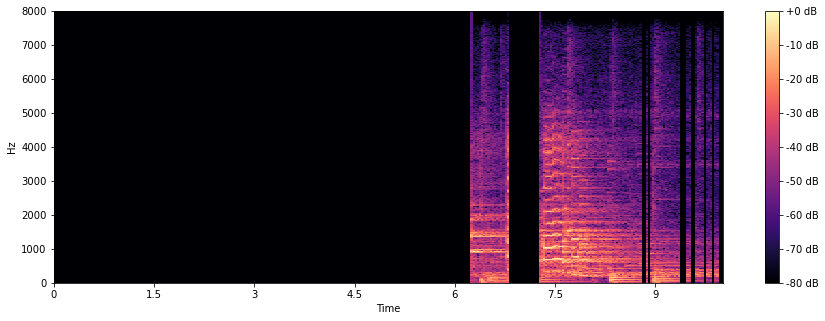

In [136]:
plt.figure(figsize=(15, 5))
librosa.display.specshow(x, sr=Fs, hop_length=hop_length, x_axis='time', y_axis='linear')
plt.colorbar(format='%+2.0f dB')

In [137]:
for i in on:
    t = i*(10/313)
    print(t)

0.0
6.198083067092652
6.773162939297125
7.220447284345048
8.753993610223642
8.881789137380192
9.329073482428115
9.488817891373802
9.680511182108626
9.808306709265175
10.0
